## 1. Image processing and Enhancement

#### Image Reading

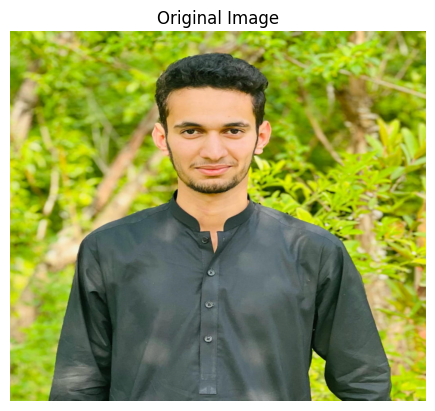

In [2]:
import cv2
from matplotlib import pyplot as plt

image_path = r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg"
image = cv2.imread(image_path)
resized_image = cv2.resize(image, (900, 800))
resized_image_rgb = cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB)
plt.imshow(resized_image_rgb)
plt.title('Original Image')
plt.axis('off')
plt.show()

#### Blurring an Image

##### 1. Gaussian Blur

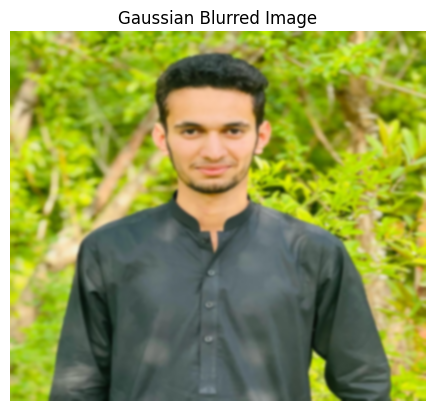

In [3]:
Gaussian = cv2.GaussianBlur(resized_image, (15, 15), 0)  
Gaussian_rgb = cv2.cvtColor(Gaussian, cv2.COLOR_BGR2RGB)  
plt.imshow(Gaussian_rgb)
plt.title('Gaussian Blurred Image')
plt.axis('off')
plt.show()

##### 2. Median Blur


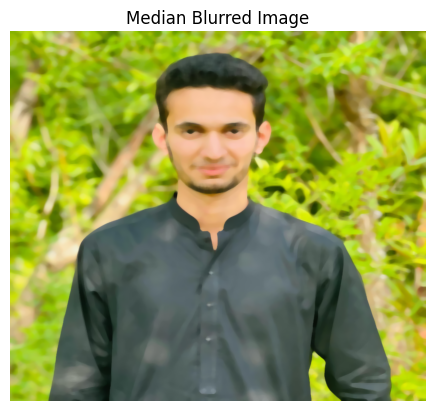

In [4]:
median = cv2.medianBlur(resized_image, 11)  
median_rgb = cv2.cvtColor(median, cv2.COLOR_BGR2RGB)  

plt.imshow(median_rgb)
plt.title('Median Blurred Image')
plt.axis('off')
plt.show()

##### 3. Bilateral Blur

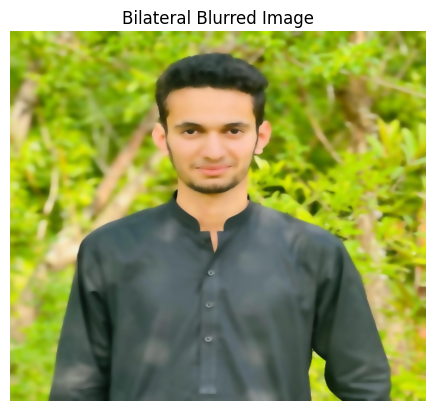

In [5]:
bilateral = cv2.bilateralFilter(resized_image, 15, 150, 150)  
bilateral_rgb = cv2.cvtColor(bilateral, cv2.COLOR_BGR2RGB)  

plt.imshow(bilateral_rgb)
plt.title('Bilateral Blurred Image')
plt.axis('off')
plt.show()

#### Grayscalling of an image

##### Method 1: Using the cv2.cvtColor() function

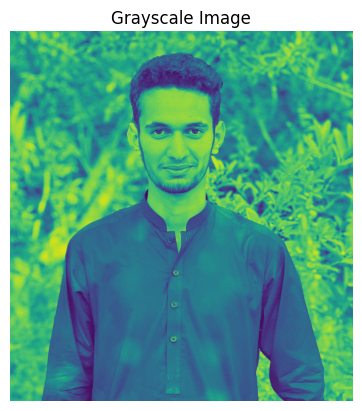

In [6]:
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
plt.imshow(gray_image)
plt.title('Grayscale Image')
plt.axis('off')
plt.show()

##### Method 2: Using the cv2.imread() function with flag=zero

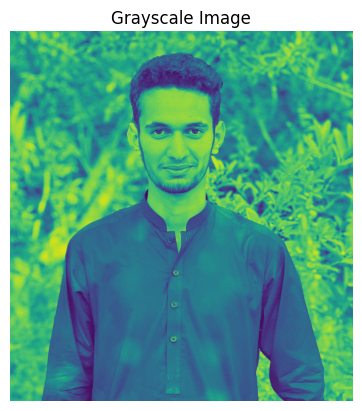

In [7]:

img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg", 0)
plt.imshow(gray_image)
plt.title('Grayscale Image')
plt.axis('off')
plt.show()

##### Method 3.1 Weighted Method (Recommended)

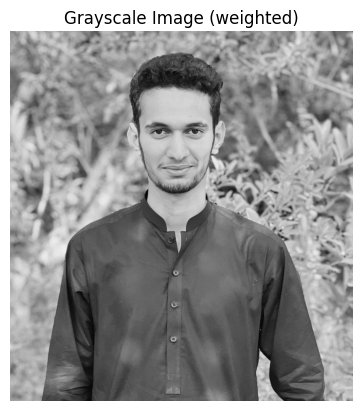

In [8]:
import cv2
import matplotlib.pyplot as plt
img_weighted = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
rows, cols = img_weighted.shape[:2]

for i in range(rows):
    for j in range(cols):
        gray = 0.2989 * img_weighted[i, j][2] + 0.5870 * img_weighted[i, j][1] + 0.1140 * img_weighted[i, j][0]
        img_weighted[i, j] = [gray, gray, gray]


plt.imshow(img_weighted)
plt.title('Grayscale Image (weighted)')
plt.axis('off')
plt.show()

##### Method 3.2: Using the pixel manipulation (Average method)

C:\Users\hp\AppData\Local\Temp\ipykernel_1784\5418844.py:8: RuntimeWarning: overflow encountered in scalar add
  gray = (img[i, j, 0] + img[i, j, 1] + img[i, j, 2]) / 3


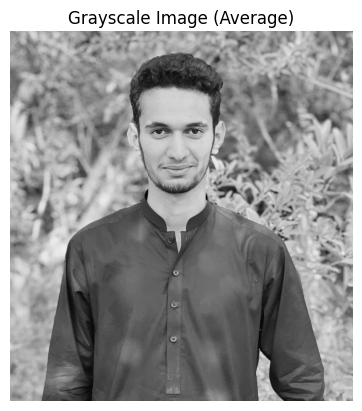

In [9]:
import cv2

img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
rows, cols = img.shape[:2]

for i in range(rows):
    for j in range(cols):
        gray = (img[i, j, 0] + img[i, j, 1] + img[i, j, 2]) / 3
        img[i, j] = [gray, gray, gray]
plt.imshow(img_weighted)
plt.title('Grayscale Image (Average)')
plt.axis('off')
plt.show()

### Image processing in python

##### 1. Image resizing

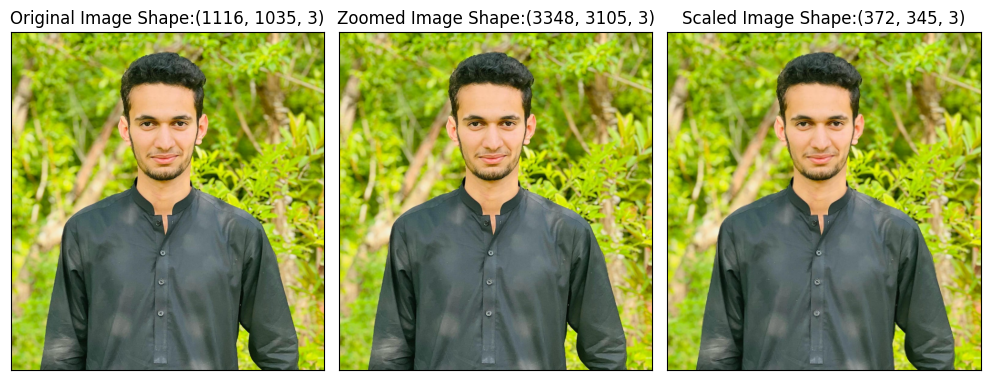

In [10]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

image = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
scale_factor_1 = 3.0  
scale_factor_2 = 1/3.0
height, width = image_rgb.shape[:2]
new_height = int(height * scale_factor_1)
new_width = int(width * scale_factor_1)

zoomed_image = cv2.resize(src =image_rgb, 
                          dsize=(new_width, new_height), 
                          interpolation=cv2.INTER_CUBIC)
                          
new_height1 = int(height * scale_factor_2)
new_width1 = int(width * scale_factor_2)
scaled_image = cv2.resize(src= image_rgb, 
                          dsize =(new_width1, new_height1), 
                          interpolation=cv2.INTER_AREA)

fig, axs = plt.subplots(1, 3, figsize=(10, 4))
axs[0].imshow(image_rgb)
axs[0].set_title('Original Image Shape:'+str(image_rgb.shape))
axs[1].imshow(zoomed_image)
axs[1].set_title('Zoomed Image Shape:'+str(zoomed_image.shape))
axs[2].imshow(scaled_image)
axs[2].set_title('Scaled Image Shape:'+str(scaled_image.shape))

for ax in axs:
    ax.set_xticks([])
    ax.set_yticks([])

plt.tight_layout()
plt.show()

##### 2. Image Rotation

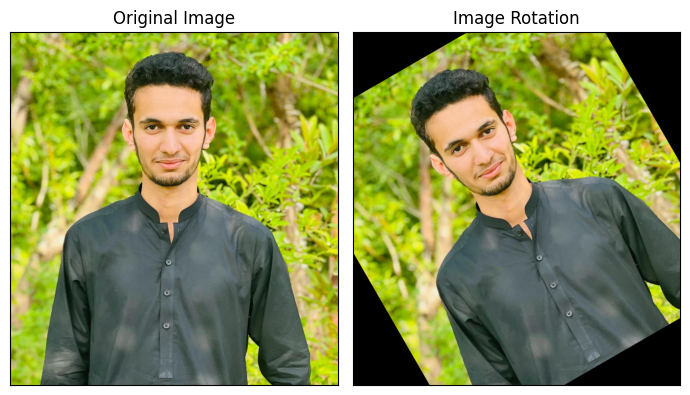

In [11]:
import cv2
import matplotlib.pyplot as plt
img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
image_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
center = (image_rgb.shape[1] // 2, image_rgb.shape[0] // 2)
angle = 30
scale = 1
rotation_matrix = cv2.getRotationMatrix2D(center, angle, scale)
rotated_image = cv2.warpAffine(image_rgb, rotation_matrix, (img.shape[1], img.shape[0]))

fig, axs = plt.subplots(1, 2, figsize=(7, 4))
axs[0].imshow(image_rgb)
axs[0].set_title('Original Image')
axs[1].imshow(rotated_image)
axs[1].set_title('Image Rotation')
for ax in axs:
    ax.set_xticks([])
    ax.set_yticks([])
    
plt.tight_layout()
plt.show()

##### 3. Image Translation

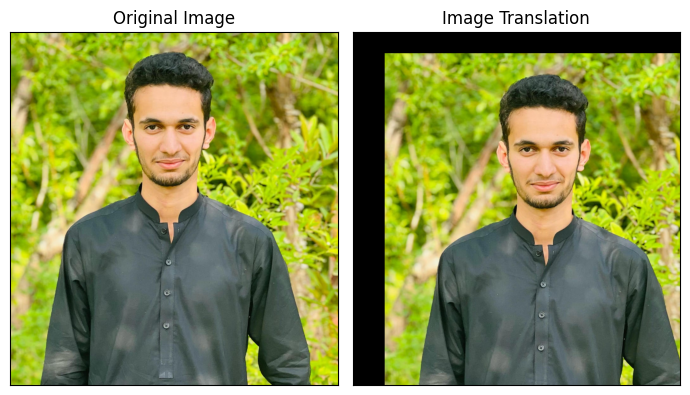

In [12]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
image_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
width, height = image_rgb.shape[1], image_rgb.shape[0]

tx, ty = 100, 70
translation_matrix = np.array([[1, 0, tx], [0, 1, ty]], dtype=np.float32)
translated_image = cv2.warpAffine(image_rgb, translation_matrix, (width, height))

fig, axs = plt.subplots(1, 2, figsize=(7, 4))
axs[0].imshow(image_rgb), axs[0].set_title('Original Image')
axs[1].imshow(translated_image), axs[1].set_title('Image Translation')

for ax in axs:
    ax.set_xticks([]), ax.set_yticks([])

plt.tight_layout()
plt.show()

##### 4. Image Shearing

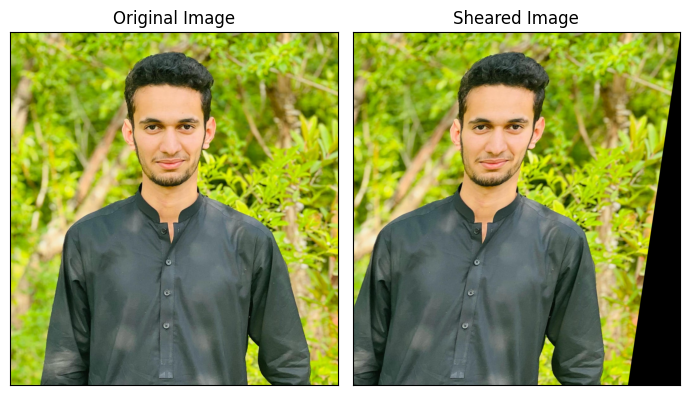

In [13]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

image = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
width, height = image_rgb.shape[1], image_rgb.shape[0]

shearX, shearY = -0.15, 0
transformation_matrix = np.array([[1, shearX, 0], [0, 1, shearY]], dtype=np.float32)
sheared_image = cv2.warpAffine(image_rgb, transformation_matrix, (width, height))

fig, axs = plt.subplots(1, 2, figsize=(7, 4))
axs[0].imshow(image_rgb), axs[0].set_title('Original Image')
axs[1].imshow(sheared_image), axs[1].set_title('Sheared Image')

for ax in axs:
    ax.set_xticks([]), ax.set_yticks([])

plt.tight_layout()
plt.show()

##### 5. Image Normalization

[[0.52941176 0.52941176 0.53333333 ... 0.47843137 0.4627451  0.43921569]
 [0.52941176 0.52941176 0.53333333 ... 0.50980392 0.49019608 0.47058824]
 [0.5254902  0.52941176 0.52941176 ... 0.55294118 0.54117647 0.5254902 ]
 ...
 [0.59607843 0.59215686 0.59215686 ... 0.60784314 0.60784314 0.61568627]
 [0.60392157 0.59607843 0.59607843 ... 0.60784314 0.60784314 0.61568627]
 [0.60784314 0.6        0.6        ... 0.60392157 0.60392157 0.60784314]]


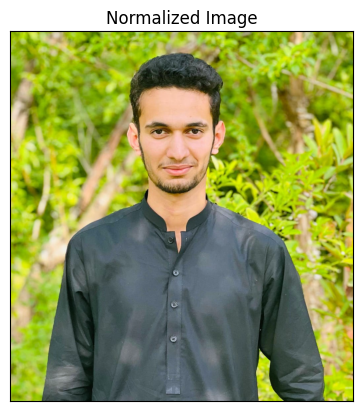

In [14]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

image = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
b, g, r = cv2.split(image_rgb)

b_normalized = cv2.normalize(b.astype('float'), None, 0, 1, cv2.NORM_MINMAX)
g_normalized = cv2.normalize(g.astype('float'), None, 0, 1, cv2.NORM_MINMAX)
r_normalized = cv2.normalize(r.astype('float'), None, 0, 1, cv2.NORM_MINMAX)

normalized_image = cv2.merge((b_normalized, g_normalized, r_normalized))
print(normalized_image[:, :, 0])

plt.imshow(normalized_image)
plt.xticks([]), 
plt.yticks([]), 
plt.title('Normalized Image')
plt.show()

##### 6. Edge detection of image

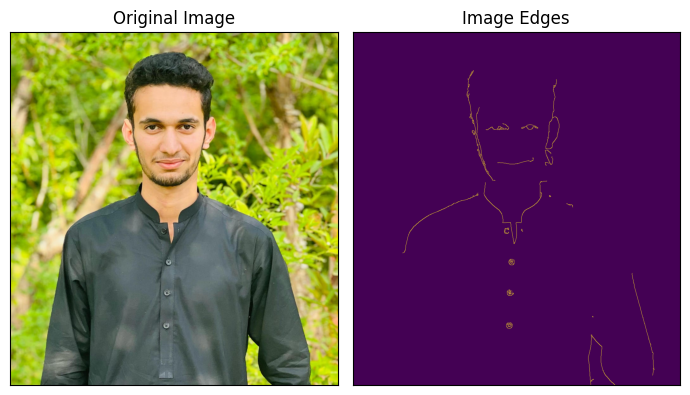

In [15]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
image_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
edges = cv2.Canny(image_rgb, 100, 700)

fig, axs = plt.subplots(1, 2, figsize=(7, 4))
axs[0].imshow(image_rgb), axs[0].set_title('Original Image')
axs[1].imshow(edges), axs[1].set_title('Image Edges')

for ax in axs:
    ax.set_xticks([]), ax.set_yticks([])

plt.tight_layout()
plt.show()

##### 7. Image Blurring

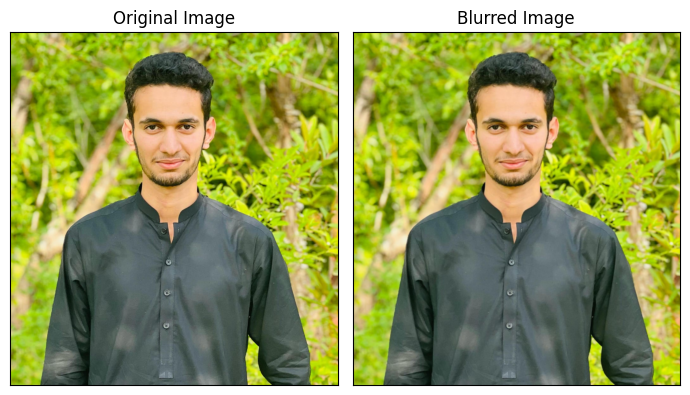

In [16]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

image = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
blurred = cv2.GaussianBlur(image, (3, 3), 0)
blurred_rgb = cv2.cvtColor(blurred, cv2.COLOR_BGR2RGB)

fig, axs = plt.subplots(1, 2, figsize=(7, 4))
axs[0].imshow(image_rgb), axs[0].set_title('Original Image')
axs[1].imshow(blurred_rgb), axs[1].set_title('Blurred Image')

for ax in axs:
    ax.set_xticks([]), ax.set_yticks([])

plt.tight_layout()
plt.show()

##### 8. Morpholical Image processing

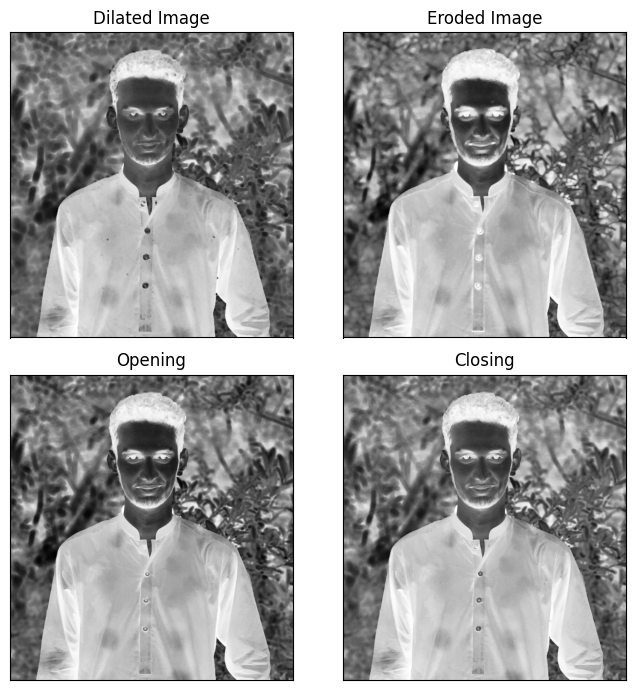

In [17]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

image = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
kernel = np.ones((3, 3), np.uint8)

dilated = cv2.dilate(image_gray, kernel, iterations=2)
eroded = cv2.erode(image_gray, kernel, iterations=2)
opening = cv2.morphologyEx(image_gray, cv2.MORPH_OPEN, kernel)
closing = cv2.morphologyEx(image_gray, cv2.MORPH_CLOSE, kernel)

fig, axs = plt.subplots(2, 2, figsize=(7, 7))
axs[0, 0].imshow(dilated, cmap='Greys'), axs[0, 0].set_title('Dilated Image')
axs[0, 1].imshow(eroded, cmap='Greys'), axs[0, 1].set_title('Eroded Image')
axs[1, 0].imshow(opening, cmap='Greys'), axs[1, 0].set_title('Opening')
axs[1, 1].imshow(closing, cmap='Greys'), axs[1, 1].set_title('Closing')

for ax in axs.flatten():
    ax.set_xticks([]), ax.set_yticks([])

plt.tight_layout()
plt.show()

### Intensity Transformation Operations

In [18]:
import cv2
import numpy as np

# Open the image.
img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")

# Apply log transform.
c = 255/(np.log(1 + np.max(img)))
log_transformed = c * np.log(1 + img)

# Specify the data type.
log_transformed = np.array(log_transformed, dtype = np.uint8)

# Save the output.
cv2.imwrite('log_transformed.jpg', log_transformed)

C:\Users\hp\AppData\Local\Temp\ipykernel_1784\902244393.py:8: RuntimeWarning: overflow encountered in scalar add
  c = 255/(np.log(1 + np.max(img)))
C:\Users\hp\AppData\Local\Temp\ipykernel_1784\902244393.py:8: RuntimeWarning: divide by zero encountered in log
  c = 255/(np.log(1 + np.max(img)))
C:\Users\hp\AppData\Local\Temp\ipykernel_1784\902244393.py:9: RuntimeWarning: divide by zero encountered in log
  log_transformed = c * np.log(1 + img)
C:\Users\hp\AppData\Local\Temp\ipykernel_1784\902244393.py:9: RuntimeWarning: invalid value encountered in multiply
  log_transformed = c * np.log(1 + img)
C:\Users\hp\AppData\Local\Temp\ipykernel_1784\902244393.py:12: RuntimeWarning: invalid value encountered in cast
  log_transformed = np.array(log_transformed, dtype = np.uint8)


True

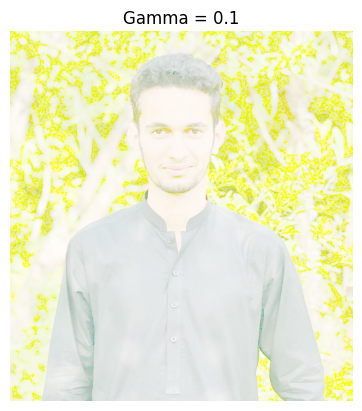

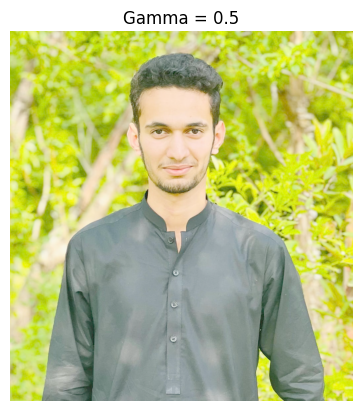

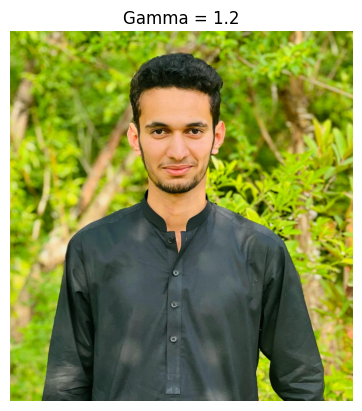

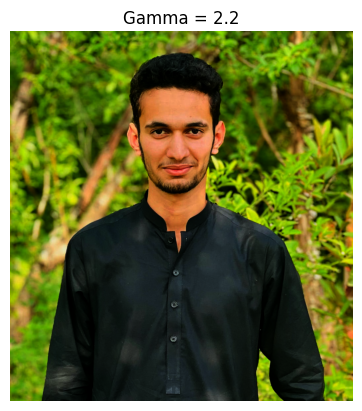

In [19]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

for gamma in [0.1, 0.5, 1.2, 2.2]:
    
    gamma_corrected = np.array(255*(img / 255) ** gamma, dtype='uint8')
    
    plt.imshow(gamma_corrected)
    plt.title("Gamma = " + str(gamma))
    plt.axis("off")
    plt.show()


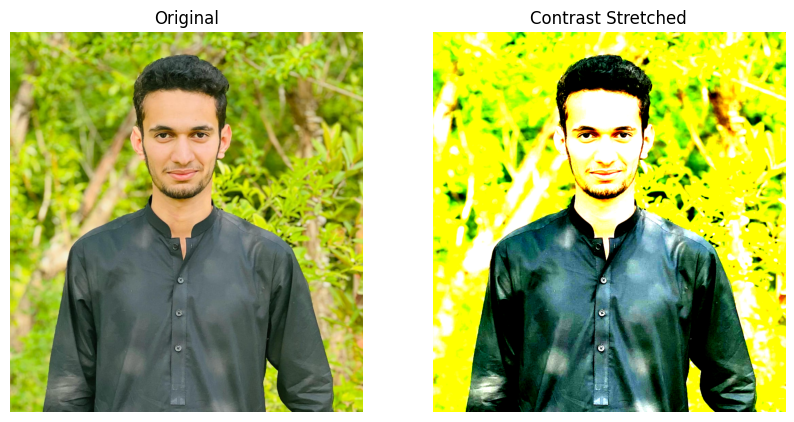

In [20]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def pixelVal(pix, r1, s1, r2, s2):
    if (0 <= pix and pix <= r1):
        return (s1 / r1) * pix
    elif (r1 < pix and pix <= r2):
        return ((s2 - s1) / (r2 - r1)) * (pix - r1) + s1
    else:
        return ((255 - s2) / (255 - r2)) * (pix - r2) + s2

img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")

r1, s1 = 70, 0
r2, s2 = 140, 255

pixelVal_vec = np.vectorize(pixelVal)

contrast_stretched = pixelVal_vec(img, r1, s1, r2, s2).astype('uint8')

# Convert for display
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
result_rgb = cv2.cvtColor(contrast_stretched, cv2.COLOR_BGR2RGB)

# Show both images
plt.figure(figsize=(10,5))

plt.subplot(1,2,1)
plt.imshow(img_rgb)
plt.title("Original")
plt.axis("off")

plt.subplot(1,2,2)
plt.imshow(result_rgb)
plt.title("Contrast Stretched")
plt.axis("off")

plt.show()


### ImageTranslation

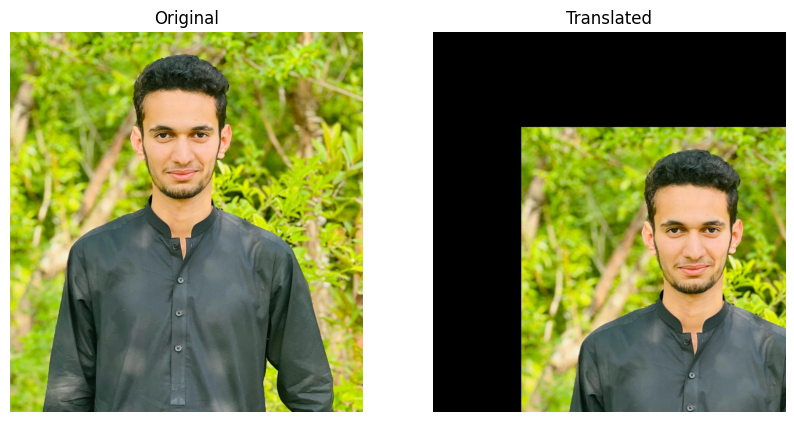

In [21]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

image = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")

height, width = image.shape[:2]
quarter_height, quarter_width = height / 4, width / 4

T = np.float32([[1, 0, quarter_width], [0, 1, quarter_height]])

img_translation = cv2.warpAffine(image, T, (width, height))

# Convert to RGB for display
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
translated_rgb = cv2.cvtColor(img_translation, cv2.COLOR_BGR2RGB)

# Show images
plt.figure(figsize=(10,5))

plt.subplot(1,2,1)
plt.imshow(image_rgb)
plt.title("Original")
plt.axis("off")

plt.subplot(1,2,2)
plt.imshow(translated_rgb)
plt.title("Translated")
plt.axis("off")

plt.show()


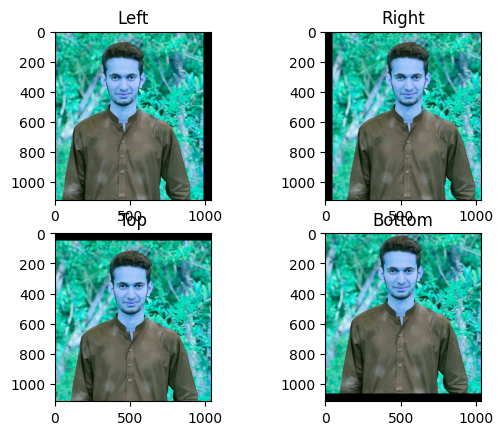

In [22]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
rows, cols, _ = img.shape

M_left = np.float32([[1, 0, -50], [0, 1, 0]])
M_right = np.float32([[1, 0, 50], [0, 1, 0]])
M_top = np.float32([[1, 0, 0], [0, 1, 50]])
M_bottom = np.float32([[1, 0, 0], [0, 1, -50]])

img_left = cv2.warpAffine(img, M_left, (cols, rows))
img_right = cv2.warpAffine(img, M_right, (cols, rows))
img_top = cv2.warpAffine(img, M_top, (cols, rows))
img_bottom = cv2.warpAffine(img, M_bottom, (cols, rows))

plt.subplot(221), plt.imshow(img_left), plt.title('Left')
plt.subplot(222), plt.imshow(img_right), plt.title('Right')
plt.subplot(223), plt.imshow(img_top), plt.title('Top')
plt.subplot(224), plt.imshow(img_bottom), plt.title('Bottom')
plt.show()

### Image Pyramid

##### 1. Pyramid Down with cv2.pyrDown()

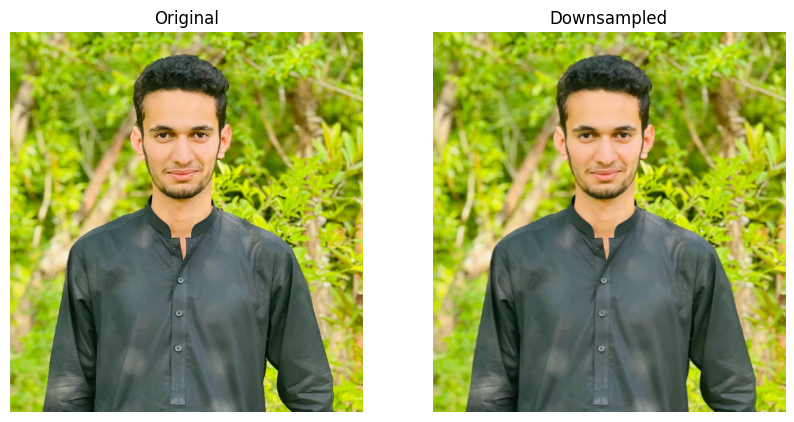

In [23]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

image = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")

downsampled_image = cv2.pyrDown(image)

# Convert to RGB
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
down_rgb = cv2.cvtColor(downsampled_image, cv2.COLOR_BGR2RGB)

# Show images
plt.figure(figsize=(10,5))

plt.subplot(1,2,1)
plt.imshow(image_rgb)
plt.title("Original")
plt.axis("off")

plt.subplot(1,2,2)
plt.imshow(down_rgb)
plt.title("Downsampled")
plt.axis("off")

plt.show()


##### 2. Pyramid Up with cv2.pyrUp()

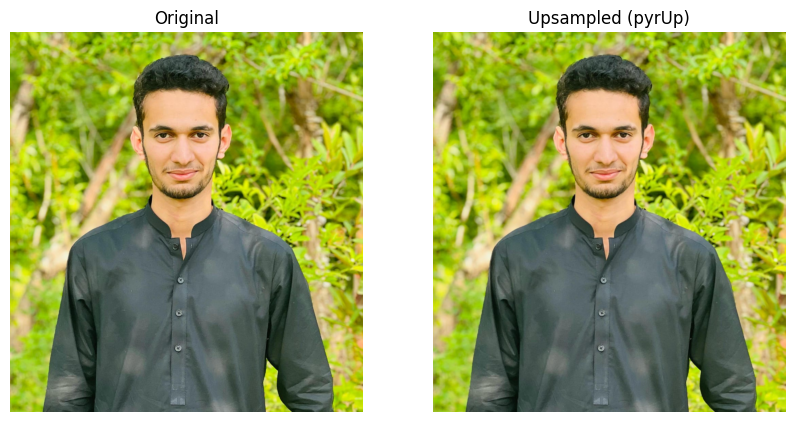

In [24]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

image = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")

upsampled_image = cv2.pyrUp(image)

# Convert to RGB for display
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
up_rgb = cv2.cvtColor(upsampled_image, cv2.COLOR_BGR2RGB)

# Show images
plt.figure(figsize=(10,5))

plt.subplot(1,2,1)
plt.imshow(image_rgb)
plt.title("Original")
plt.axis("off")

plt.subplot(1,2,2)
plt.imshow(up_rgb)
plt.title("Upsampled (pyrUp)")
plt.axis("off")

plt.show()


##### 3 .Building a Gaussian Pyramid

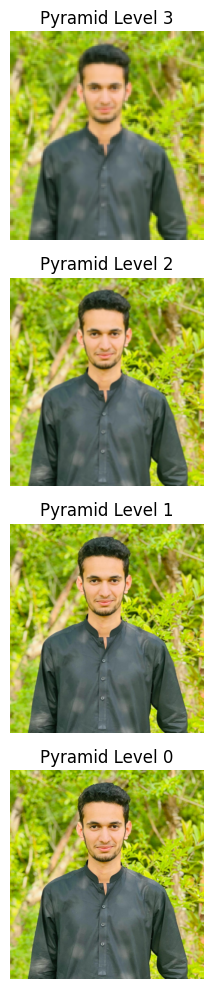

In [25]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

image = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")

pyramid = [image]

for i in range(3):
    image = cv2.pyrDown(image)
    pyramid.append(image)

plt.figure(figsize=(8,10))

# IMPORTANT: reverse order display
for i in range(len(pyramid)-1, -1, -1):
    
    img_rgb = cv2.cvtColor(pyramid[i], cv2.COLOR_BGR2RGB)
    
    plt.subplot(len(pyramid),1,len(pyramid)-i)
    plt.imshow(img_rgb)
    plt.title(f"Pyramid Level {i}")
    plt.axis("off")

plt.tight_layout()
plt.show()


### Histograms Equalization

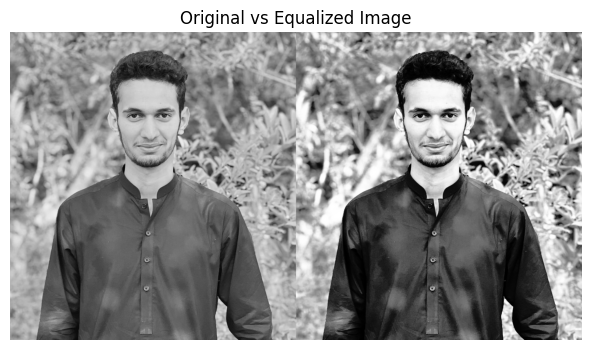

In [26]:
img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg", 0 )
 
equ = cv2.equalizeHist(img)
res = np.hstack((img, equ))
plt.figure(figsize=(9, 4))
plt.imshow(res, cmap='gray')  
plt.title("Original vs Equalized Image")
plt.axis('off')  
plt.show()

### Changing Color Spaces

##### 1. Convert BGR to Grayscale

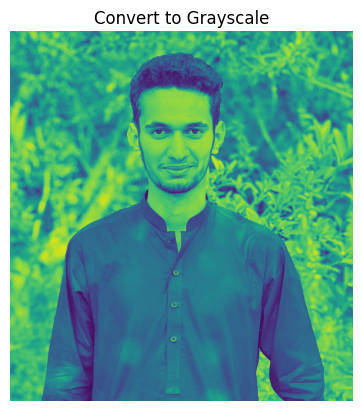

In [27]:
import cv2
src = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")

gray_image = cv2.cvtColor(src, cv2.COLOR_BGR2GRAY)

plt.imshow(gray_image)  
plt.title("Convert to Grayscale")
plt.axis('off')  
plt.show()

##### 2. Convert BGR to HSV

(np.float64(-0.5), np.float64(1034.5), np.float64(1115.5), np.float64(-0.5))

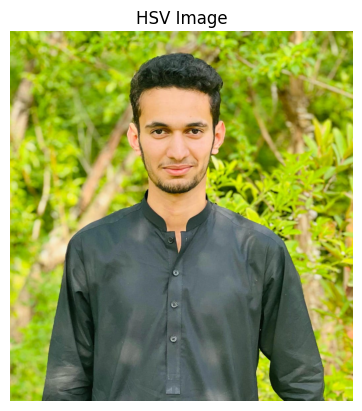

In [28]:
import cv2
import matplotlib.pyplot as plt

src = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")

hsv_image = cv2.cvtColor(src, cv2.COLOR_BGR2HSV)

# Convert HSV to RGB for display
hsv_display = cv2.cvtColor(hsv_image, cv2.COLOR_HSV2RGB)

plt.imshow(hsv_display)
plt.title("HSV Image")
plt.axis("off")


##### 3. Convert BGR to RGB

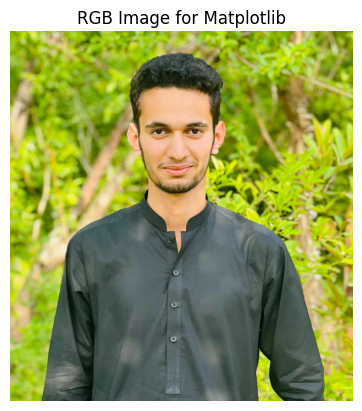

In [29]:
import cv2
import matplotlib.pyplot as plt
src = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")

# Convert from BGR to RGB
rgb_image = cv2.cvtColor(src, cv2.COLOR_BGR2RGB)

# Display with Matplotlib
plt.imshow(rgb_image)
plt.title("RGB Image for Matplotlib")
plt.axis('off')
plt.show()

### Visualizing image in different color spaces

##### 1. RGB Image

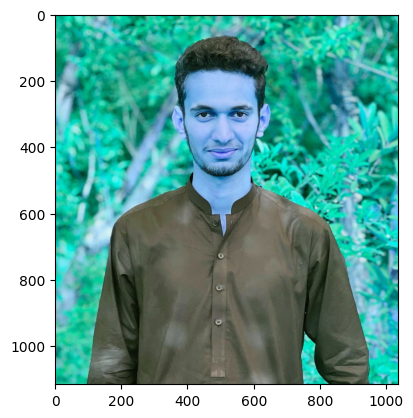

In [30]:
# Python program to read image as RGB
import cv2
import matplotlib.pyplot as plt

# reads image as RGB
img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")

# shows the image
plt.imshow(img)

##### 2. Gray Scale Image

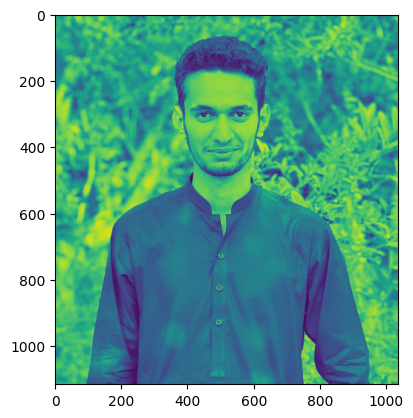

In [31]:
import cv2
import matplotlib.pyplot as plt
img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
plt.imshow(img)

##### 3. YCrCb Color Space

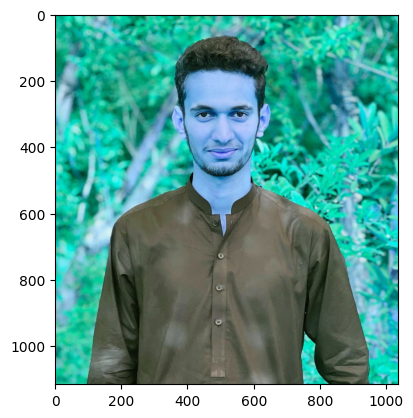

In [32]:
import cv2
import matplotlib.pyplot as plt
img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")

# Convert to YCrCb color space
img1 = cv2.cvtColor(img, cv2.COLOR_BGR2YCrCb)

# Shows the image
plt.imshow(img)


##### 4. HSV color space

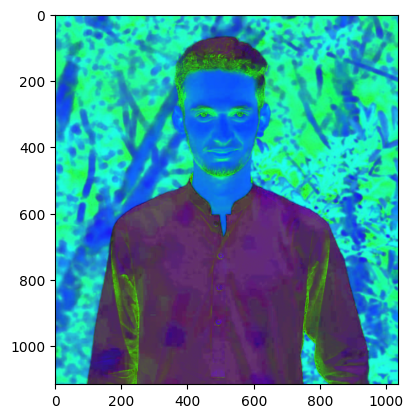

In [33]:
import cv2
import matplotlib.pyplot as plt
# Reads the image
img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
# Converts to HSV color space
img = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
plt.imshow(img)

##### 5. Lab color space

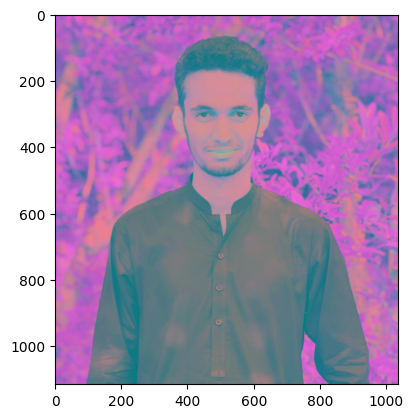

In [34]:
import cv2
import matplotlib.pyplot as plt
img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
img = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
plt.imshow(img)


##### 6. Edge map of image

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-327.0..332.0].


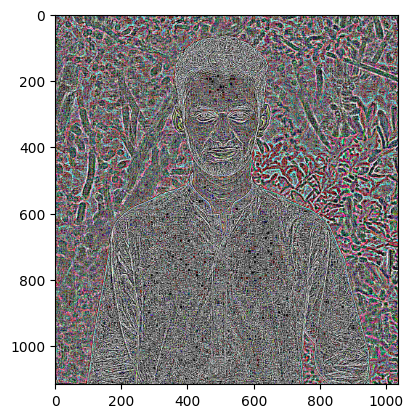

In [35]:
import cv2
import matplotlib.pyplot as plt
img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
laplacian = cv2.Laplacian(img, cv2.CV_64F)
plt.imshow(laplacian)

##### 7. Heat map of image

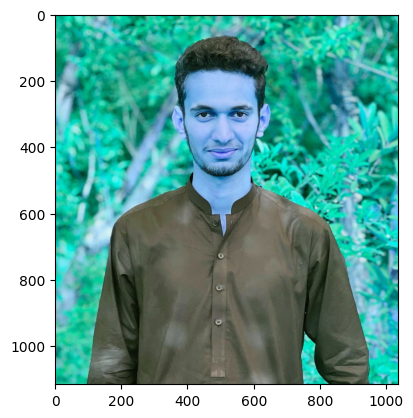

In [36]:
import matplotlib.pyplot as plt
import cv2

img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")

plt.imshow(img, cmap ='hot')

## 2.Image Segmentation and Thresholding

### Simple Thresholding

In [37]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

image = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

In [38]:
def show_image(img, title):
    plt.imshow(img, cmap='gray')
    plt.title(title)
    plt.axis('off')
    plt.show()

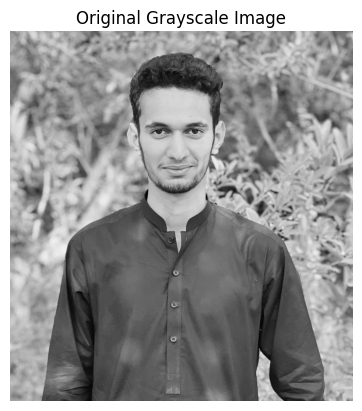

In [39]:
show_image(gray_image, 'Original Grayscale Image')

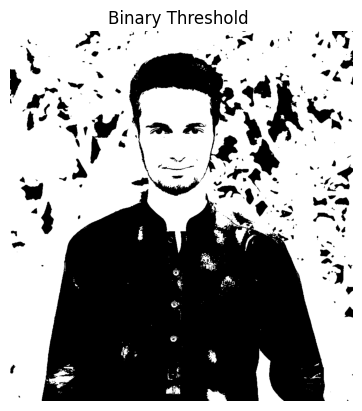

In [40]:
_, thresh_binary = cv2.threshold(gray_image, 120, 255, cv2.THRESH_BINARY)
show_image(thresh_binary, 'Binary Threshold ')

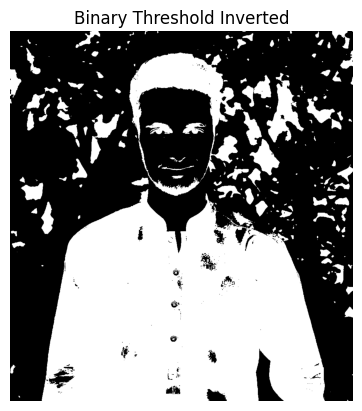

In [41]:
_, thresh_binary_inv = cv2.threshold(
    gray_image, 120, 255, cv2.THRESH_BINARY_INV)
show_image(thresh_binary_inv, 'Binary Threshold Inverted')

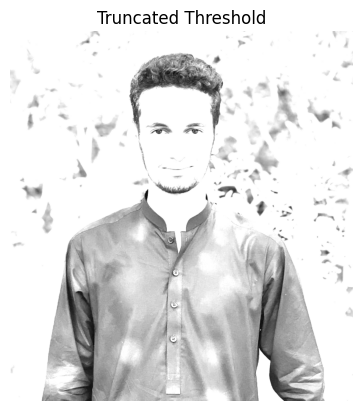

In [42]:
_, thresh_trunc = cv2.threshold(gray_image, 120, 255, cv2.THRESH_TRUNC)
show_image(thresh_trunc, 'Truncated Threshold')

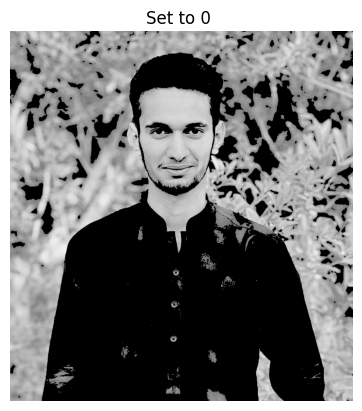

In [43]:
_, thresh_tozero = cv2.threshold(gray_image, 120, 255, cv2.THRESH_TOZERO)
show_image(thresh_tozero, 'Set to 0 ')

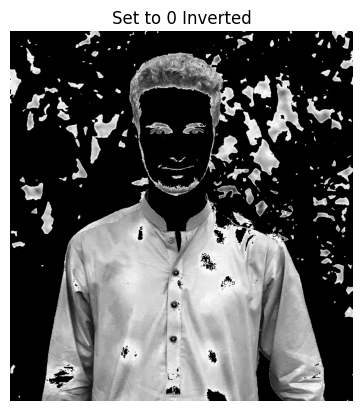

In [44]:
_, thresh_tozero_inv = cv2.threshold(
    gray_image, 120, 255, cv2.THRESH_TOZERO_INV)
show_image(thresh_tozero_inv, 'Set to 0 Inverted')

### Adaptive Thresholding

In [45]:
import cv2
import matplotlib.pyplot as plt

image = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

In [46]:
def show_image(img, title):
    plt.imshow(img, cmap='gray')
    plt.title(title)
    plt.axis('off')
    plt.show()

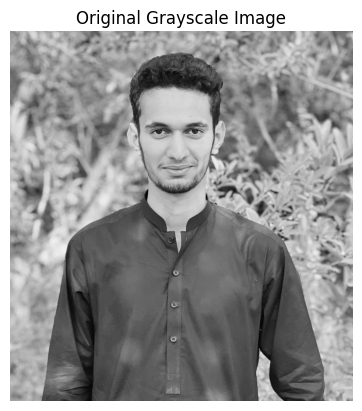

In [47]:
show_image(gray_image, "Original Grayscale Image")

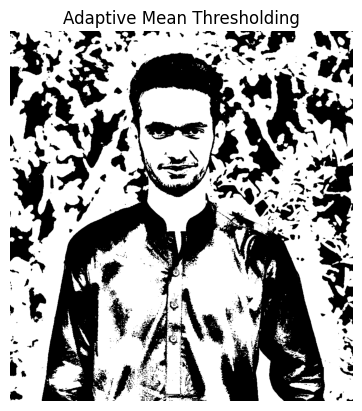

In [48]:
thresh_mean = cv2.adaptiveThreshold(
    gray_image, 255,
    cv2.ADAPTIVE_THRESH_MEAN_C,
    cv2.THRESH_BINARY,
    199, 5
)
show_image(thresh_mean, "Adaptive Mean Thresholding")

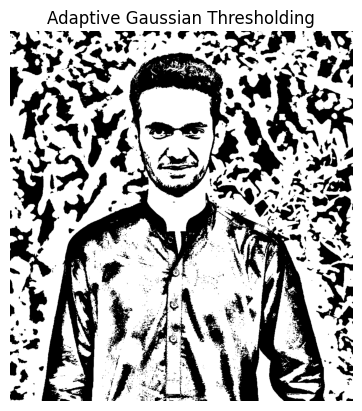

In [49]:
thresh_gauss = cv2.adaptiveThreshold(
    gray_image, 255,
    cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
    cv2.THRESH_BINARY,
    199, 5
)
show_image(thresh_gauss, "Adaptive Gaussian Thresholding")

### Otsu Thresholding 

In [50]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

image = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

In [51]:
def show_image(img, title):
    plt.imshow(img, cmap='gray')
    plt.title(title)
    plt.axis('off')
    plt.show()

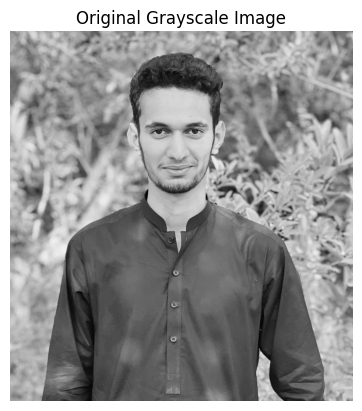

In [52]:
show_image(gray_image, "Original Grayscale Image")

Calculated Otsu threshold value: 131.0


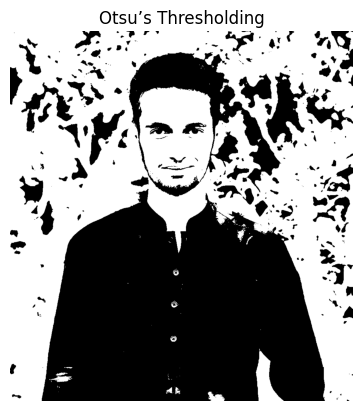

In [53]:
ret, otsu_thresh = cv2.threshold(
    gray_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
print("Calculated Otsu threshold value:", ret)
show_image(otsu_thresh, "Otsu’s Thresholding")

### Image segmentation using Morphological operations

In [54]:
import numpy as np
import cv2
from matplotlib import pyplot as plt
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
blurred = cv2.GaussianBlur(gray, (5, 5), 0)

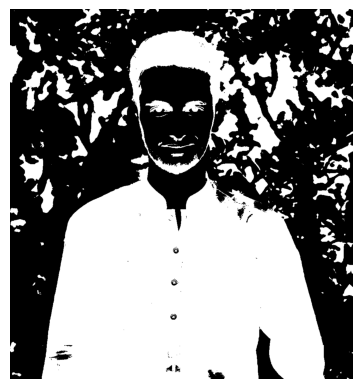

In [55]:
ret, thresh = cv2.threshold(
    gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
plt.imshow(thresh, cmap='gray')
plt.axis('off')
plt.show()

In [56]:
kernel = np.ones((9, 9), np.uint8)
closing = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel, iterations=3)

bg = cv2.dilate(closing, kernel, iterations=2)

In [57]:
contours, _ = cv2.findContours(
    closing, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
result = np.zeros(gray.shape, dtype=np.uint8)
for contour in contours:
    if cv2.contourArea(contour) > 1000:
        cv2.fillPoly(result, [contour], 255)

In [58]:
kernel_open = np.ones((6, 6), np.uint8)
opened_result = cv2.morphologyEx(
    result, cv2.MORPH_OPEN, kernel_open, iterations=2)

kernel_erode = np.ones((9, 9), np.uint8)
final_result = cv2.erode(opened_result, kernel_erode, iterations=2)

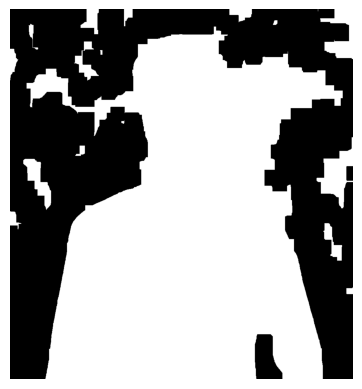

In [59]:
final_result = cv2.erode(opened_result, kernel_erode, iterations=2)
plt.imshow(final_result, cmap='gray')
plt.axis('off')
plt.show()

## 3. Morphological Operations & Filtering

### Erosion and Dilation of images

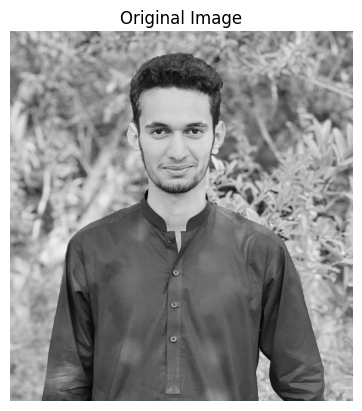

In [60]:
import cv2
from matplotlib import pyplot as plt

img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg", 0)

plt.imshow(img, cmap='gray')
plt.title("Original Image")
plt.axis("off")
plt.show()

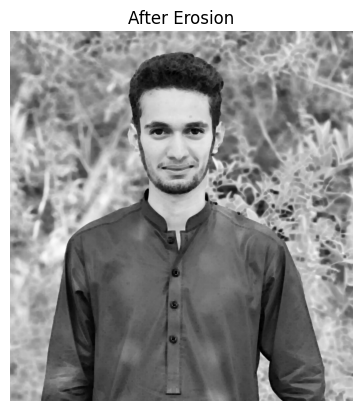

In [61]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg", 0)
kernel = np.ones((5,5), np.uint8)

# Erosion apply
img_erosion = cv2.erode(img, kernel, iterations=1)

plt.imshow(img_erosion, cmap='gray')
plt.title("After Erosion")
plt.axis("off")
plt.show()

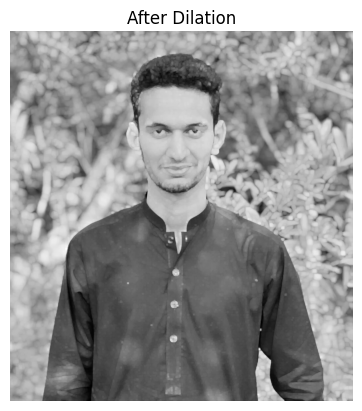

In [62]:
img_dilation = cv2.dilate(img, kernel, iterations=1)

plt.imshow(img_dilation, cmap='gray')
plt.title("After Dilation")
plt.axis('off')
plt.show()

In [63]:
import cv2

# Read the image.
img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
# Apply bilateral filter with d = 15, 
# sigmaColor = sigmaSpace = 75.
bilateral = cv2.bilateralFilter(img, 15, 75, 75)

# Save the output.
cv2.imwrite('taj_bilateral.jpg', bilateral)

True

### Denoising of colored images

(<Axes: title={'center': 'Denoised Image'}>,
 Text(0.5, 1.0, 'Denoised Image'))

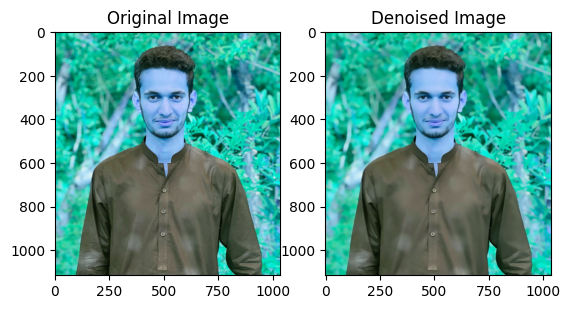

In [64]:
# Importing required libraries
import numpy as np
import cv2
from matplotlib import pyplot as plt

# Reading the noisy image from file
img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")

# Applying denoising filter
dst = cv2.fastNlMeansDenoisingColored(img, None, 10, 10, 7, 15)

# Displaying original and denoised images
plt.subplot(121), plt.imshow(img), plt.title('Original Image')
plt.subplot(122), plt.imshow(dst), plt.title('Denoised Image')

### Filter Color with OpenCV

In [65]:
import cv2
import numpy as np

cap = cv2.VideoCapture(0)  # Start webcam

while True:
    _, frame = cap.read()
    
    # Convert BGR to HSV
    hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)
    
    # Define range for blue color in HSV
    lower_blue = np.array([60, 35, 140])
    upper_blue = np.array([180, 255, 255])

    # Create mask
    mask = cv2.inRange(hsv, lower_blue, upper_blue)
    
    # Filter the blue region
    result = cv2.bitwise_and(frame, frame, mask=mask)

    # Show frames
    cv2.imshow('Original Frame', frame)
    cv2.imshow('Blue Mask', mask)
    cv2.imshow('Blue Filtered Result', result)

    # Press 'q' to quit
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break  # Exit the loop when 'q' is pressed

cap.release()
cv2.destroyAllWindows()
print("Exiting...")  # Confirm exit

Exiting...


### Python OpenCV - Morphological Operations

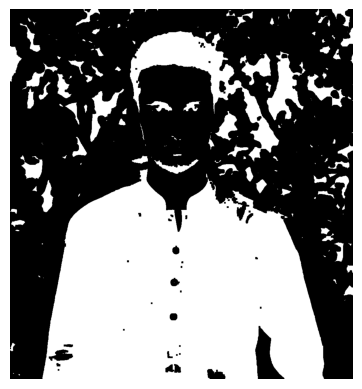

(<matplotlib.image.AxesImage at 0x25413861090>,
 (np.float64(-0.5), np.float64(1034.5), np.float64(1115.5), np.float64(-0.5)),
 None)

In [66]:
import cv2, numpy as np, matplotlib.pyplot as plt
img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg", 0) 
bin = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]  # Binarize

k = np.ones((5, 5), np.uint8)  # Define 5x5 kernel
inv = cv2.bitwise_not(bin)                                 
out = cv2.erode(inv, k, 1)              
plt.imshow(out, cmap='gray'), plt.axis('off'), plt.show()

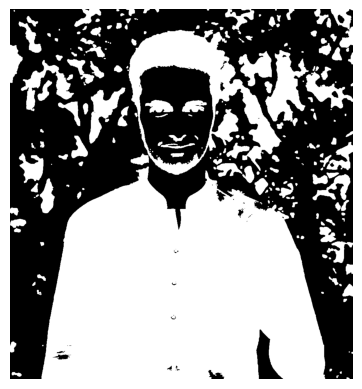

(<matplotlib.image.AxesImage at 0x25413863610>,
 (np.float64(-0.5), np.float64(1034.5), np.float64(1115.5), np.float64(-0.5)),
 None)

In [67]:
import cv2, numpy as np, matplotlib.pyplot as plt

img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg", 0)  # Load grayscale image
bin = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]  # Binarize

k = np.ones((3, 3), np.uint8) # Define 3x3 kernel
inv = cv2.bitwise_not(bin)        
out = cv2.dilate(inv, k, 1)      
plt.imshow(out, cmap='gray'), plt.axis('off'), plt.show()

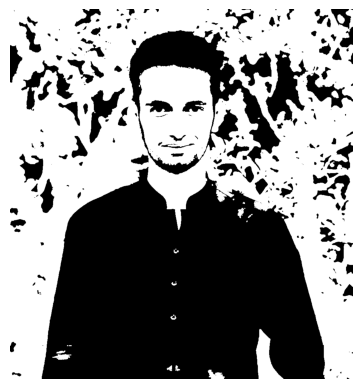

(<matplotlib.image.AxesImage at 0x25413807d90>,
 (np.float64(-0.5), np.float64(1034.5), np.float64(1115.5), np.float64(-0.5)),
 None)

In [68]:
import cv2, numpy as np, matplotlib.pyplot as plt

img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg", 0) 
bin = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]  # Binarize

k = np.ones((3, 3), np.uint8)  # 3x3 kernel
opened = cv2.morphologyEx(bin, cv2.MORPH_OPEN, k)
plt.imshow(opened, cmap='gray'), plt.axis('off'), plt.show()

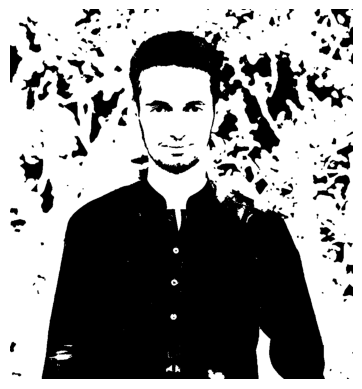

(<matplotlib.image.AxesImage at 0x2541387c190>,
 (np.float64(-0.5), np.float64(1034.5), np.float64(1115.5), np.float64(-0.5)),
 None)

In [69]:
import cv2, numpy as np, matplotlib.pyplot as plt

img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg", 0)
bin = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]

k = np.ones((3, 3), np.uint8)
closed = cv2.morphologyEx(bin, cv2.MORPH_CLOSE, k)  # Apply closing
plt.imshow(closed, cmap='gray'), plt.axis('off'), plt.show()

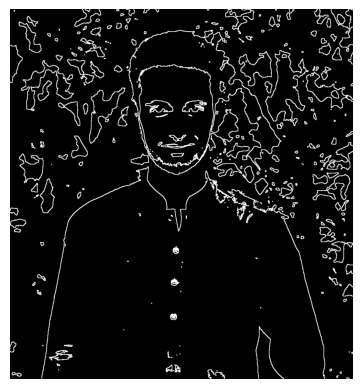

(<matplotlib.image.AxesImage at 0x2541387e710>,
 (np.float64(-0.5), np.float64(1034.5), np.float64(1115.5), np.float64(-0.5)),
 None)

In [70]:
import cv2, numpy as np, matplotlib.pyplot as plt
img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg", 0)  # Load grayscale image
bin = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]  # Binarize

k = np.ones((3, 3), np.uint8)  # Define 3x3 kernel
inv = cv2.bitwise_not(bin)  
out = cv2.morphologyEx(inv, cv2.MORPH_GRADIENT, k) 
plt.imshow(out, cmap='gray'), plt.axis('off'), plt.show()

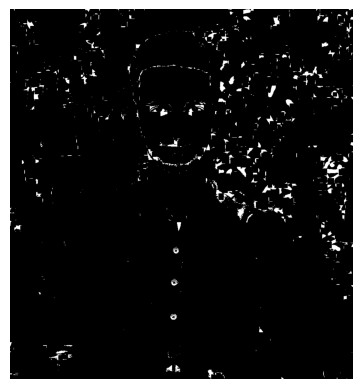

(<matplotlib.image.AxesImage at 0x2540d4c0cd0>,
 (np.float64(-0.5), np.float64(1034.5), np.float64(1115.5), np.float64(-0.5)),
 None)

In [71]:
import cv2, numpy as np, matplotlib.pyplot as plt
img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg", 0)

bin = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]
k = np.ones((13, 13), np.uint8)
top = cv2.morphologyEx(bin, cv2.MORPH_TOPHAT, k)
plt.imshow(top, cmap='gray'), plt.axis('off'), plt.show()

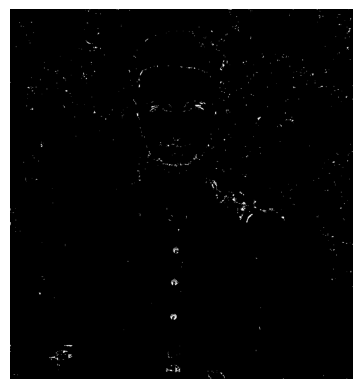

(<matplotlib.image.AxesImage at 0x2540d4c3250>,
 (np.float64(-0.5), np.float64(1034.5), np.float64(1115.5), np.float64(-0.5)),
 None)

In [72]:
import cv2, numpy as np, matplotlib.pyplot as plt
img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg", 0)

bin = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]
inv = cv2.bitwise_not(bin)
k = np.ones((5, 5), np.uint8)
bh = cv2.morphologyEx(inv, cv2.MORPH_BLACKHAT, k)
plt.imshow(bh, cmap='gray'), plt.axis('off'), plt.show()

### Morphological Operations in Image Processing (Opening)

In [73]:
import cv2  
import numpy as np  

# Start capturing from webcam
screenRead = cv2.VideoCapture(0)

while True:
    # Capture a single frame from the webcam
    _, image = screenRead.read()
    
    # Convert to HSV color space
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    
    # Define blue color range
    blue1 = np.array([110, 50, 50])
    blue2 = np.array([130, 255, 255])
    
    # Create binary mask for blue color
    mask = cv2.inRange(hsv, blue1, blue2)

    # Define 5x5 structuring element (kernel)
    kernel = np.ones((5, 5), np.uint8)
    
    # Apply Opening to remove small white noise
    opening = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    # Show both original mask and cleaned version
    cv2.imshow('Original Blue Mask', mask)
    cv2.imshow('After Opening (Noise Removed)', opening)
    
    # Press 'a' key to stop
    if cv2.waitKey(1) & 0xFF == ord('a'):
        break

# Clean up
cv2.destroyAllWindows()
screenRead.release()

### Morphological Operations in Image Processing (Closing)

In [74]:
import cv2  
import numpy as np  

# Start capturing from webcam  
screenRead = cv2.VideoCapture(0)

while True:
    # Capture a single frame from the webcam
    _, image = screenRead.read()
    
    # Convert to HSV color space
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    
    # Define blue color range
    blue1 = np.array([110, 50, 50])
    blue2 = np.array([130, 255, 255])
    
    # Create binary mask for blue color
    mask = cv2.inRange(hsv, blue1, blue2)

    # Define 5x5 structuring element (kernel)
    kernel = np.ones((5, 5), np.uint8)
    
    # Apply Closing to fill small black holes in the object
    closing = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
   
    # Show both original mask and result after closing
    cv2.imshow('Original Blue Mask', mask)
    cv2.imshow('After Closing (Holes Filled)', closing)
    
    # Press 'a' key to stop
    if cv2.waitKey(1) & 0xFF == ord('a'):
        break

# Clean up
cv2.destroyAllWindows()
screenRead.release()

### Morphological Operations in Image Processing (Gradient)

In [75]:
import cv2  
import numpy as np  

# Start capturing from webcam  
screenRead = cv2.VideoCapture(0)

while True:
    # Capture a single frame from the webcam
    _, image = screenRead.read()
    
    # Convert to HSV color space
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    
    # Define blue color range
    blue1 = np.array([110, 50, 50])
    blue2 = np.array([130, 255, 255])
    
    # Create binary mask for blue color
    mask = cv2.inRange(hsv, blue1, blue2)

    # Define 5x5 structuring element (kernel)
    kernel = np.ones((5, 5), np.uint8)
    
    # Apply Gradient to highlight object boundaries
    gradient = cv2.morphologyEx(mask, cv2.MORPH_GRADIENT, kernel)
   
    # Show both original mask and result after gradient
    cv2.imshow('Original Blue Mask', mask)
    cv2.imshow('After Gradient (Edges Highlighted)', gradient)
    
    # Press 'a' key to stop
    if cv2.waitKey(1) & 0xFF == ord('a'):
        break

# Clean up
cv2.destroyAllWindows()
screenRead.release()

## 4. Advanced Image Manipulation & Background Subtraction

### Image Inpainting using OpenCV

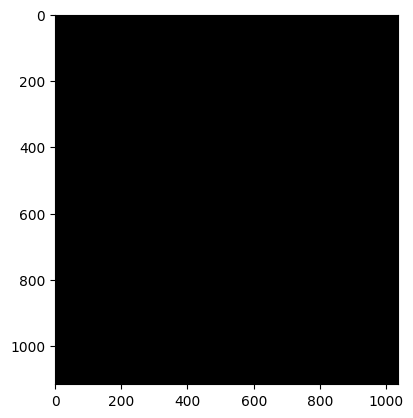

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
# reading the damaged image
damaged_img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")

# get the shape of the image
height, width = damaged_img.shape[0], damaged_img.shape[1]

# Converting all pixels greater than zero to black while black becomes white
for i in range(height):
    for j in range(width):
        if damaged_img[i, j].sum() > 0:
            damaged_img[i, j] = 0
        else:
            damaged_img[i, j] = [255, 255, 255]

# saving the mask 
mask = damaged_img
cv2.imwrite('mask.jpg', mask)
plt.imshow(mask)

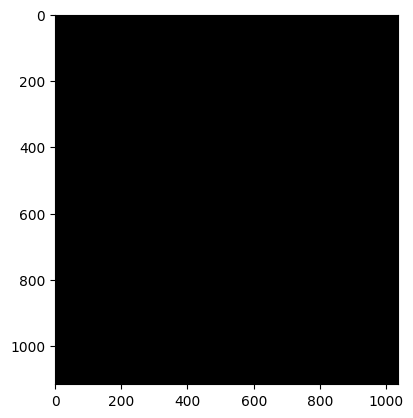

In [84]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
# reading the damaged image
damaged_img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")

# get the shape of the image
height, width = damaged_img.shape[0], damaged_img.shape[1]

# Converting all pixels greater than zero to black while black becomes white
for i in range(height):
    for j in range(width):
        if damaged_img[i, j].sum() > 0:
            damaged_img[i, j] = 0
        else:
            damaged_img[i, j] = [255, 255, 255]

# saving the mask 
mask = damaged_img
cv2.imwrite('mask.jpg', mask)

# displaying mask
plt.imshow(mask)

### Image Registration using OpenCV

Output saved!


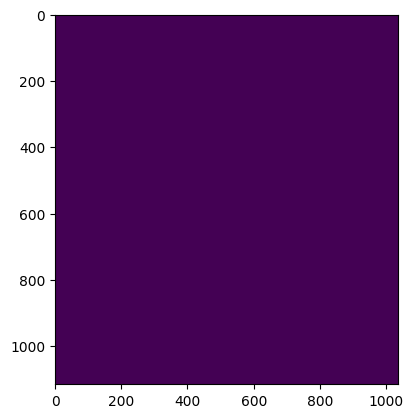

In [ ]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt
img_path = r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg"

# Check if file exists
if not os.path.exists(img_path):
    print("Error: Image file exist nahi karti!")
else:
    img_color = cv2.imread(img_path)
    if img_color is None:
        print("Error: img_color None → path ya file galat hai")
    else:
        # Convert to HSV
        hsv = cv2.cvtColor(img_color, cv2.COLOR_BGR2HSV)

        # Blue color mask
        lower_blue = np.array([110, 50, 50])
        upper_blue = np.array([130, 255, 255])
        mask = cv2.inRange(hsv, lower_blue, upper_blue)

        # Gradient
        kernel = np.ones((5,5), np.uint8)
        gradient = cv2.morphologyEx(mask, cv2.MORPH_GRADIENT, kernel)

        # Show
        plt.imshow(img_color)
        plt.imshow(mask)
        plt.imshow(gradient)

        # Save outputs
        cv2.imwrite(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\blue_mask.jpg", mask)
        cv2.imwrite(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\blue_gradient.jpg", gradient)
        print("Output saved!")


### Background subtraction using OpenCV

Foreground mask saved at: C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\foreground_mask.jpg


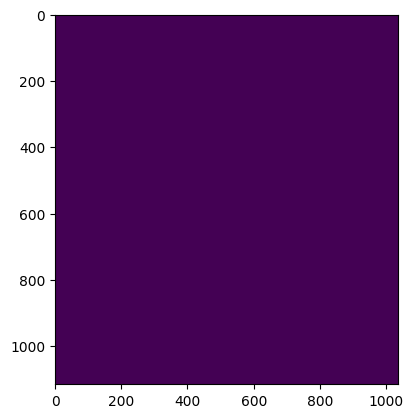

In [87]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt
img_path = r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg"

if not os.path.exists(img_path):
    print("Error: Image file exist nahi karti!")
else:
    # Read the image
    frame = cv2.imread(img_path)
    if frame is None:
        print("Error: img_color None → path ya file galat hai")
    else:
        # Create background subtractor
        fgbg = cv2.createBackgroundSubtractorMOG2()

        # Apply background subtraction (single image)
        fgmask = fgbg.apply(frame)

        # Show original and mask
        plt.imshow(frame)
        plt.imshow(fgmask)

        output_path = r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\foreground_mask.jpg"
        cv2.imwrite(output_path, fgmask)
        print(f"Foreground mask saved at: {output_path}")

        # cv2.waitKey(0)
        # cv2.destroyAllWindows()


### Background Subtraction in an Image

Running average saved at: C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\running_average.jpg


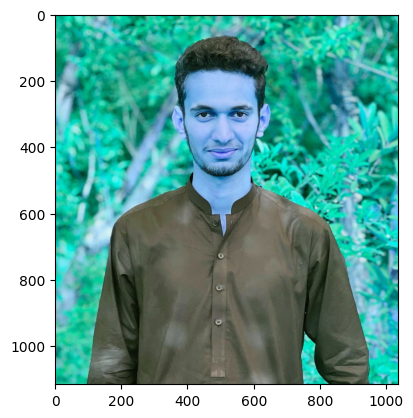

In [ ]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt
# Tumhara photo path
img_path = r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg"

if not os.path.exists(img_path):
    print("Error: Image file exist nahi karti!")
else:
    # Read the image
    img = cv2.imread(img_path)
    if img is None:
        print("Error: Image load nahi hui → path ya file galat hai")
    else:
        # Convert to float
        averageValue1 = np.float32(img)

        # For demonstration, we can simulate "update" a few times
        # Normally running average is for video, here just repeating same image
        for i in range(5):
            cv2.accumulateWeighted(img, averageValue1, 0.02)
        
        # Convert back to 8-bit for display
        resultingFrames1 = cv2.convertScaleAbs(averageValue1)

        # Show original and "background model"
        plt.imshow(img)
        plt.imshow(resultingFrames1)

        # Save the result if needed
        output_path = r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\running_average.jpg"
        cv2.imwrite(output_path, resultingFrames1)
        print(f"Running average saved at: {output_path}")



### Foreground Extraction in an Image using Grabcut Algorithm

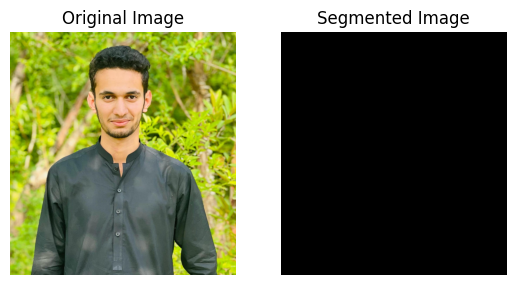

In [77]:
import numpy as np
import cv2
from matplotlib import pyplot as plt
image = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
 
# create a simple mask image similar
# to the loaded image, with the 
# shape and return type
mask = np.zeros(image.shape[:2], np.uint8)
 
# specify the background and foreground model
# using numpy the array is constructed of 1 row
# and 65 columns, and all array elements are 0
# Data type for the array is np.float64 (default)
backgroundModel = np.zeros((1, 65), np.float64)
foregroundModel = np.zeros((1, 65), np.float64)
 
# define the Region of Interest (ROI)
# as the coordinates of the rectangle
# where the values are entered as
# (startingPoint_x, startingPoint_y, width, height)
# these coordinates are according to the input image
# it may vary for different images
rectangle = (20, 100, 150, 150)
 
# apply the grabcut algorithm with appropriate
# values as parameters, number of iterations = 3 
# cv2.GC_INIT_WITH_RECT is used because
# of the rectangle mode is used 
cv2.grabCut(image, mask, rectangle,  
            backgroundModel, foregroundModel,
            3, cv2.GC_INIT_WITH_RECT)
 
# In the new mask image, pixels will 
# be marked with four flags 
# four flags denote the background / foreground 
# mask is changed, all the 0 and 2 pixels 
# are converted to the background
# mask is changed, all the 1 and 3 pixels
# are now the part of the foreground
# the return type is also mentioned,
# this gives us the final mask
mask2 = np.where((mask == 2)|(mask == 0), 0, 1).astype('uint8')
 
# The final mask is multiplied with 
# the input image to give the segmented image.
image_segmented = image * mask2[:, :, np.newaxis]
 
# output segmented image with colorbar
plt.subplot(1, 2, 1)
plt.title('Original Image')
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.axis('off')

# Display the segmented image
plt.subplot(1, 2, 2)
plt.title('Segmented Image')
plt.imshow(cv2.cvtColor(image_segmented, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.show()

## 5. Feature Detection and Description

In [ ]:
import cv2
import numpy as np

img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")

gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

edges = cv2.Canny(gray, 50, 150, apertureSize=3)

lines = cv2.HoughLines(edges, 1, np.pi/180, 200)

# ONLY THIS PART ADDED
if lines is not None:

    for r_theta in lines:
        arr = np.array(r_theta[0], dtype=np.float64)
        r, theta = arr

        a = np.cos(theta)
        b = np.sin(theta)

        x0 = a*r
        y0 = b*r

        x1 = int(x0 + 1000*(-b))
        y1 = int(y0 + 1000*(a))

        x2 = int(x0 - 1000*(-b))
        y2 = int(y0 - 1000*(a))

        cv2.line(img, (x1, y1), (x2, y2), (0, 0, 255), 2)

else:
    print("No lines detected")

cv2.imwrite('linesDetected.jpg', img)


True

In [79]:
import cv2
import numpy as np

# Read image
image = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")

# Convert image to grayscale
gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)

# Use canny edge detection
edges = cv2.Canny(gray,50,150,apertureSize=3)

# Apply HoughLinesP method to 
# to directly obtain line end points
lines_list =[]
lines = cv2.HoughLinesP(
            edges, # Input edge image
            1, # Distance resolution in pixels
            np.pi/180, # Angle resolution in radians
            threshold=100, # Min number of votes for valid line
            minLineLength=5, # Min allowed length of line
            maxLineGap=10 # Max allowed gap between line for joining them
            )

# Iterate over points
for points in lines:
      # Extracted points nested in the list
    x1,y1,x2,y2=points[0]
    # Draw the lines joing the points
    # On the original image
    cv2.line(image,(x1,y1),(x2,y2),(0,255,0),2)
    # Maintain a simples lookup list for points
    lines_list.append([(x1,y1),(x2,y2)])
    
# Save the result image
cv2.imwrite('detectedLines.png',image)

True

### Circle Detection using OpenCV

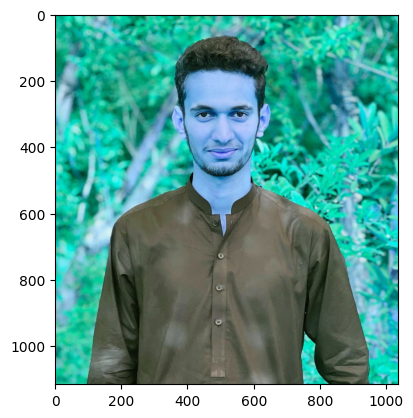

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
# Read image
img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
output = img.copy()
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Reduce noise
gray = cv2.medianBlur(gray, 5)

# Detect circles
circles = cv2.HoughCircles(
    gray,
    cv2.HOUGH_GRADIENT,
    dp=1,
    minDist=100,      
    param1=100,         
    param2=40,       
    minRadius=30,       
    maxRadius=60
)

# Draw only the first detected circle
if circles is not None:
    circles = np.uint16(np.around(circles))
    x, y, r = circles[0][0]
    cv2.circle(output, (x, y), r, (0, 255, 0), 2)  # Circle outline
    cv2.circle(output, (x, y), 2, (0, 0, 255), 3)  # Center point
plt.imshow(output)

### Detect corner of an image using OpenCV

In [89]:
import numpy as np
import cv2
from matplotlib import pyplot as plt

In [90]:
img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

In [91]:
corners = cv2.goodFeaturesToTrack(
    gray,
    maxCorners=27,
    qualityLevel=0.01,
    minDistance=10,
    blockSize=3,
    useHarrisDetector=False,
    k=0.04
)

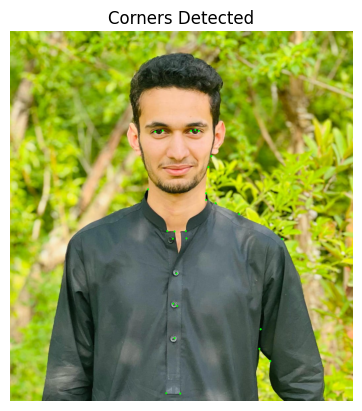

In [92]:
corners = np.intp(corners)  # Convert to integer coords
for corner in corners:
    x, y = corner.ravel()
    cv2.circle(img, (x, y), radius=3, color=(0, 255, 0), thickness=-1)

plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.title('Corners Detected')
plt.axis('off')
plt.show()

### Corner Detection with Shi-Tomasi Corner Detection

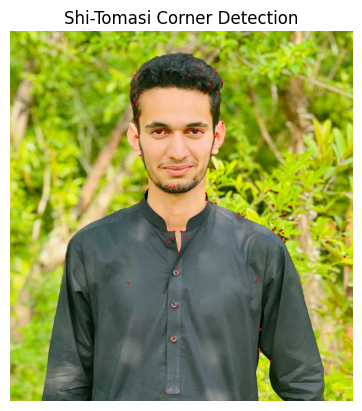

In [93]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")

gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

corners = cv2.goodFeaturesToTrack(gray_img, 100, 0.01, 10)
corners = np.int32(corners)

for i in corners:
    x, y = i.ravel()
    cv2.circle(img, (x, y), 3, (0, 0, 255), -1)  

img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

plt.imshow(img_rgb)
plt.title('Shi-Tomasi Corner Detection')
plt.axis('off')  
plt.show()

### Corner detection with Harris Corner Detection 


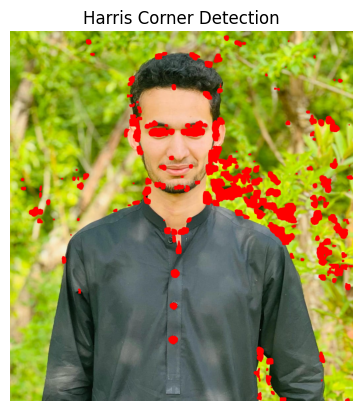

In [94]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

image_path =(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
image = cv2.imread(image_path)

operatedImage = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
operatedImage = np.float32(operatedImage)


dest = cv2.cornerHarris(operatedImage, 17, 21, 0.01)
dest = cv2.dilate(dest, None)

image[dest > 0.01 * dest.max()] = [0, 0, 255]
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

plt.imshow(image_rgb)
plt.title('Harris Corner Detection')
plt.axis('off')  
plt.show()

### Find Circles and Ellipses in an Image using OpenCV 

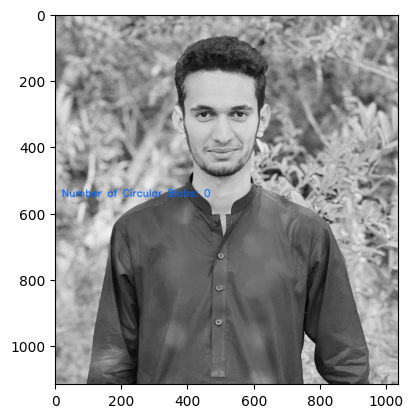

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
# Load image
image = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg", 0)
# Set our filtering parameters
# Initialize parameter setting using cv2.SimpleBlobDetector
params = cv2.SimpleBlobDetector_Params()

# Set Area filtering parameters
params.filterByArea = True
params.minArea = 100

# Set Circularity filtering parameters
params.filterByCircularity = True 
params.minCircularity = 0.9

# Set Convexity filtering parameters
params.filterByConvexity = True
params.minConvexity = 0.2
    
# Set inertia filtering parameters
params.filterByInertia = True
params.minInertiaRatio = 0.01

# Create a detector with the parameters
detector = cv2.SimpleBlobDetector_create(params)
    
# Detect blobs
keypoints = detector.detect(image)

# Draw blobs on our image as red circles
blank = np.zeros((1, 1)) 
blobs = cv2.drawKeypoints(image, keypoints, blank, (0, 0, 255),
                          cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

number_of_blobs = len(keypoints)
text = "Number of Circular Blobs: " + str(len(keypoints))
cv2.putText(blobs, text, (20, 550),
            cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 100, 255), 2)

# Show blobs
plt.imshow(blobs)

### Document field detection using Template Matching

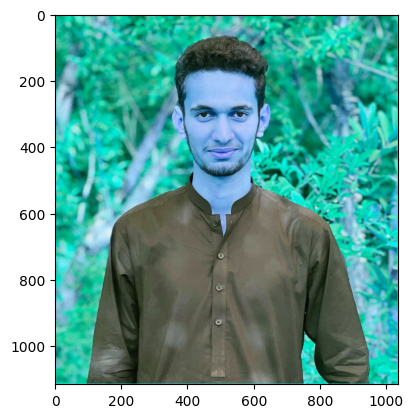

In [98]:
import numpy as np
import imutils
import cv2
import matplotlib.pyplot as plt
field_threshold = { "prev_policy_no" : 0.7,
                    "address"        : 0.6,
                  }

# Function to Generate bounding
# boxes around detected fields
def getBoxed(img, img_gray, template, field_name = "policy_no"):

    w, h = template.shape[::-1] 

    # Apply template matching
    res = cv2.matchTemplate(img_gray, template,
                           cv2.TM_CCOEFF_NORMED)

    hits = np.where(res >= field_threshold[field_name])

    # Draw a rectangle around the matched region. 
    for pt in zip(*hits[::-1]): 
        cv2.rectangle(img, pt, (pt[0] + w, pt[1] + h),
                                    (0, 255, 255), 2)

        y = pt[1] - 10 if pt[1] - 10 > 10 else pt[1] + h + 20

        cv2.putText(img, field_name, (pt[0], y),
            cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 0, 255), 1)

    return img


# Driver Function
if __name__ == '__main__':

    # Read the original document image
    img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
      
    # 3-d to 2-d conversion
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
     
    # Field templates
    template_add = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg", 0)
    template_prev = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg", 0)

    img = getBoxed(img.copy(), img_gray.copy(),
                       template_add, 'address')

    img = getBoxed(img.copy(), img_gray.copy(),
                   template_prev, 'prev_policy_no')

    plt.imshow(img)

### Smile detection using OpenCV


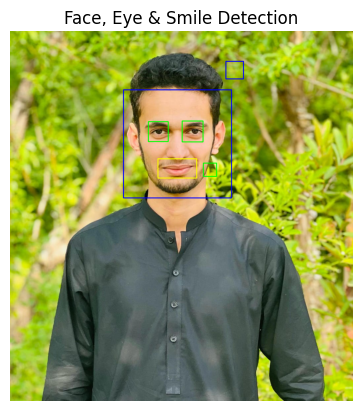

In [102]:
import cv2
import matplotlib.pyplot as plt

# Load Haar cascades
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
eye_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_eye.xml')
smile_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_smile.xml')

# Read input image
img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")

# Safety check
if img is None:
    print("Image not loaded. Check path!")
    exit()

# Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Detect faces
faces = face_cascade.detectMultiScale(gray, 1.3, 5)

for (x, y, w, h) in faces:
    cv2.rectangle(img, (x, y), (x + w, y + h), (255, 0, 0), 2)

    roi_gray = gray[y:y+h, x:x+w]

    # Detect eyes
    eyes = eye_cascade.detectMultiScale(roi_gray)
    for (ex, ey, ew, eh) in eyes:
        cv2.rectangle(img, (x+ex, y+ey),
                      (x+ex+ew, y+ey+eh), (0, 255, 0), 2)

    # Detect smile
    smiles = smile_cascade.detectMultiScale(
        roi_gray, 1.8, 20, minSize=(25, 25))
    for (sx, sy, sw, sh) in smiles:
        cv2.rectangle(img, (x+sx, y+sy),
                      (x+sx+sw, y+sy+sh), (0, 255, 255), 2)

# Convert BGR → RGB (important for matplotlib)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Show using matplotlib
plt.imshow(img_rgb)
plt.axis("off")
plt.title("Face, Eye & Smile Detection")
plt.show()

### Feature extraction and image classification using OpenCV

In [103]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [105]:
image = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg")
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

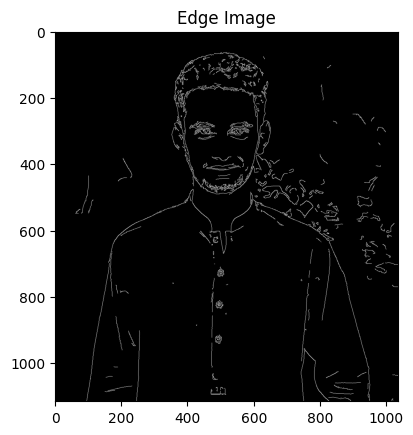

In [106]:
edges = cv2.Canny(gray_image, 100, 200)
plt.imshow(edges, cmap='gray')
plt.title('Edge Image')
plt.show()

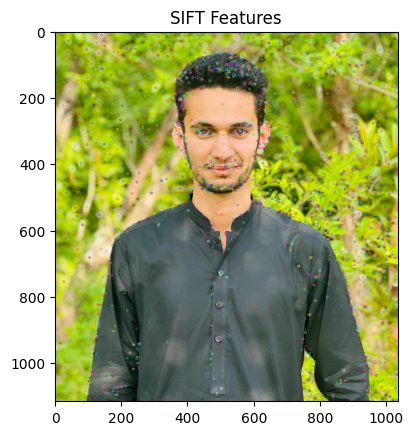

In [107]:
sift = cv2.SIFT_create()
keypoints, descriptors = sift.detectAndCompute(gray_image, None)
image_with_sift = cv2.drawKeypoints(image, keypoints, None)
plt.imshow(cv2.cvtColor(image_with_sift, cv2.COLOR_BGR2RGB))
plt.title('SIFT Features')
plt.show()

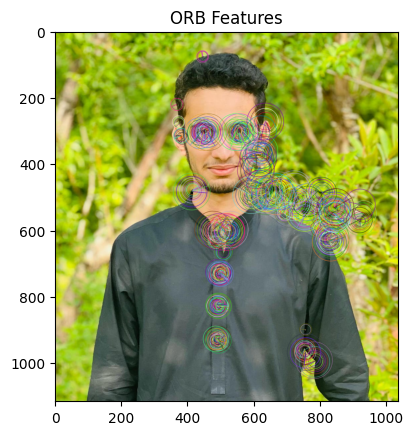

In [108]:
orb = cv2.ORB_create()
keypoints, descriptors = orb.detectAndCompute(gray_image, None)
image_with_orb = cv2.drawKeypoints(image, keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
plt.imshow(cv2.cvtColor(image_with_orb, cv2.COLOR_BGR2RGB))
plt.title('ORB Features')
plt.show()

## 6. Feature Detection & Analysis

### Find Co-ordinates of Contours using OpenCV 

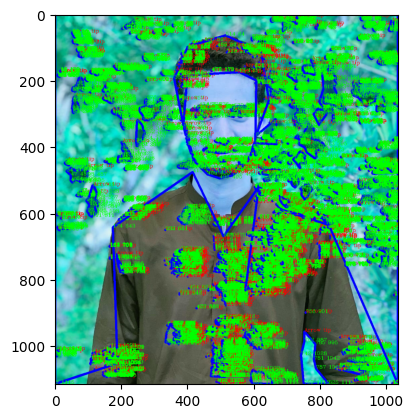

In [110]:
import numpy as np
import os
import cv2
import matplotlib.pyplot as plt
font = cv2.FONT_HERSHEY_COMPLEX

# Load image
img2 = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg", cv2.IMREAD_COLOR)
img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg", cv2.IMREAD_GRAYSCALE)

# Check if image loaded
if img2 is None or img is None:
    raise FileNotFoundError("Image not found! Check your path and extension.")

# Binarize image
_, threshold = cv2.threshold(img, 110, 255, cv2.THRESH_BINARY)

# Find contours
contours, _ = cv2.findContours(threshold, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

for cnt in contours:
    # Approximate and draw contour
    approx = cv2.approxPolyDP(cnt, 0.009 * cv2.arcLength(cnt, True), True)
    cv2.drawContours(img2, [approx], 0, (0, 0, 255), 5)

    # Flatten points
    n = approx.ravel()
    i = 0
    for j in n:
        if i % 2 == 0:  # x, y coords
            x, y = n[i], n[i + 1]
            coord = f"{x} {y}"
            if i == 0:  # first point
                cv2.putText(img2, "Arrow tip", (x, y), font, 0.5, (255, 0, 0))
            else:
                cv2.putText(img2, coord, (x, y), font, 0.5, (0, 255, 0))
        i += 1

# Show result
plt.imshow(img2)
# cv2.waitKey(0)
# cv2.destroyAllWindows()


### OpenCV Python Program to analyze an image using Histogram

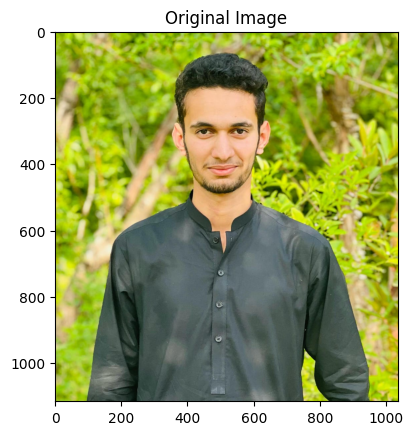

In [111]:
import matplotlib.pyplot as plt
import cv2

img = plt.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg") 
plt.imshow(img)
plt.title("Original Image")
plt.show()

C:\Users\hp\AppData\Local\Temp\ipykernel_1784\2589556971.py:7: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.10; the parameter will become keyword-only in 3.12.
  plt.subplot(122), plt.hist(g.ravel(),256,[0,256],color='k'), plt.title("Gray Histogram")


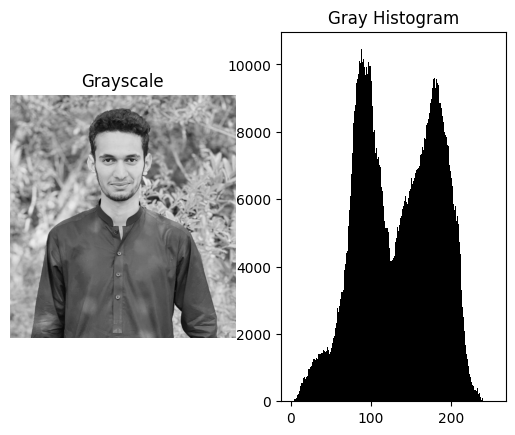

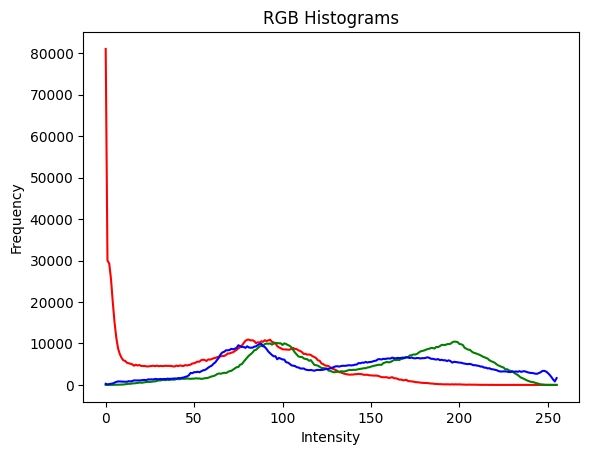

In [112]:
import cv2, matplotlib.pyplot as plt
img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg") 

# Grayscale + Histogram
g = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
plt.subplot(121), plt.imshow(g, cmap='gray'), plt.axis("off"), plt.title("Grayscale")
plt.subplot(122), plt.hist(g.ravel(),256,[0,256],color='k'), plt.title("Gray Histogram")
plt.show()

# RGB Histograms
for i,c in enumerate(('r','g','b')):
    plt.plot(cv2.calcHist([img],[i],None,[256],[0,256]), color=c)
plt.title("RGB Histograms"), plt.xlabel("Intensity"), plt.ylabel("Frequency")
plt.show()

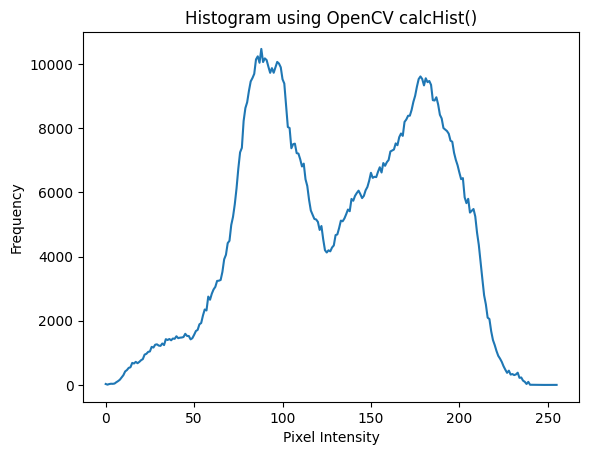

In [113]:
img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg", 0) 
histg = cv2.calcHist([img], [0], None, [256], [0, 256])

# Plot histogram
plt.plot(histg)
plt.title("Histogram using OpenCV calcHist()")
plt.xlabel("Pixel Intensity")
plt.ylabel("Frequency")
plt.show()

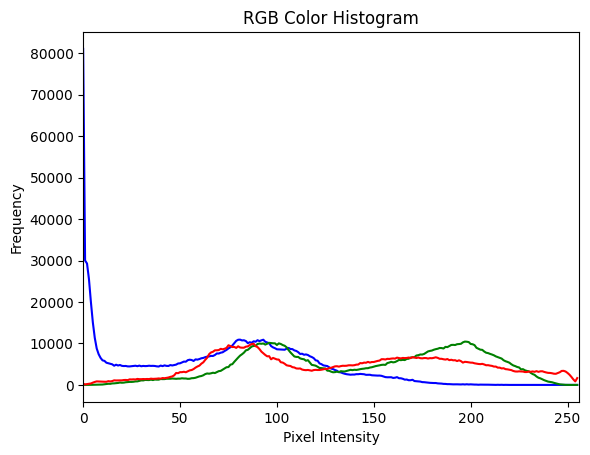

In [114]:
img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg") 

# colors for channels
colors = ('b', 'g', 'r')

for i, col in enumerate(colors):
    hist = cv2.calcHist([img], [i], None, [256], [0, 256])
    plt.plot(hist, color=col)
    plt.xlim([0, 256])

plt.title("RGB Color Histogram")
plt.xlabel("Pixel Intensity")
plt.ylabel("Frequency")
plt.show()

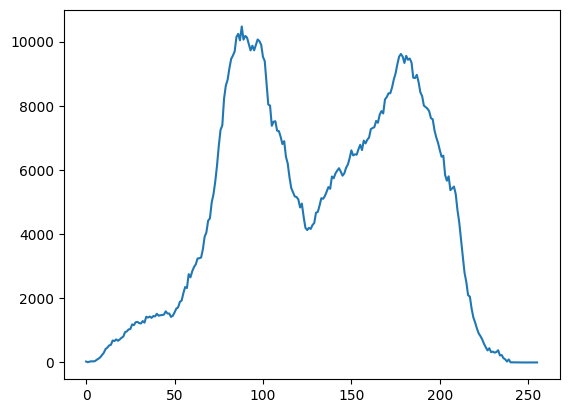

In [115]:
import cv2
from matplotlib import pyplot as plt
img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg", 0) 

histr = cv2.calcHist([img],[0],None,[256],[0,256])
plt.plot(histr)
plt.show()

C:\Users\hp\AppData\Local\Temp\ipykernel_1784\2094504435.py:6: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.10; the parameter will become keyword-only in 3.12.
  plt.hist(img.ravel(),256,[0,256])


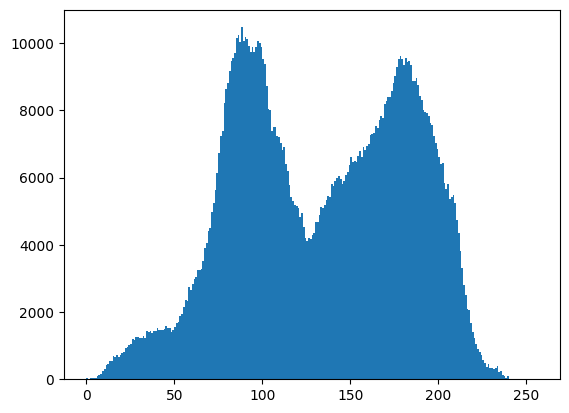

In [116]:
import cv2
from matplotlib import pyplot as plt
img = cv2.imread(r"C:\Users\hp\Desktop\4th Semester\PAI-Lab\Lab 5\1.jpeg", 0) 

# alternative way to find histogram of an image
plt.hist(img.ravel(),256,[0,256])
plt.show()